# Import Libraries and Data

In [28]:
# To retrieve contents of directories/folders
import os
# To manipulate data
import pandas as pd
import numpy as np
# To manipulate and visualize spatial data
import geopandas as gpd
import fiona
from shapely.geometry import Polygon, LineString, Point
# To create static plots
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from matplotlib.colors import ListedColormap
# To create interactive plots
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import contextily as ctx
# To make sub plots
from plotly.subplots import make_subplots
# To scrape website content
# pip install selenium
import selenium
from selenium.webdriver.common.keys import Keys
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.common.action_chains import ActionChains
from selenium.common.exceptions import NoSuchElementException
from selenium.common.exceptions import TimeoutException
from selenium.common.exceptions import StaleElementReferenceException
## To install browser drivers
# For Selenium 4
# pip install webdriver-manager
from selenium.webdriver.chrome.service import Service as ChromeService
from webdriver_manager.chrome import ChromeDriverManager
import time
# To import data from ArcGIS Server
import urllib.parse
import requests

In [30]:
# Check working directory
cwd = os.getcwd()
print('Current Working Directory is: ', cwd)
# Set dataframe view options so all column names and rows are shown
pd.options.display.max_columns = None
pd.options.display.max_rows = None

Current Working Directory is:  /home/jovyan/up221-group-project/up221-group-project/Group Assignments


# Entitlement Applications

### Import parcel boundaries and entitlement application data

In [8]:
# Import parcel SHP - clipped with ArcPro
parcel_chinatown_path = os.path.join("/home/jovyan/up221-group-project/up221-group-project/Data/Parcel Geographic Boundaries/LA_County_Parcels_Feature_Clip.zip")
parcel_chinatown = gpd.read_file(parcel_chinatown_path,dtype={'AIN':str})
# Import CSV of parcels with entitlement applications in Chinatown
entitlements = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LA City Planning Data/Chinatown/entitlements_ain_parcels_chinatown.csv")

### Clean entitlement application data

#### Trim by selected columns in entitlement application dataframe

In [250]:
# Create list of desired columns
desired_columns = ['AIN','SitusFullA','YearBuilt1','Roll_LandV','Roll_ImpVa','CASE_NBR',
                  'UnitTypeDescription','ProposedToBeDemolished','ProposedAdding','ApprovedToBeDemolished',
                   'ApprovedAdding','SpecialGroups','FILING_DT','CASE_DEEM_CMPLT_DT','HEARING_DT',
                   'COMPLETION_DT','DETERMINATION','cts TAPLC.PROJ_DESC_TXT','cts TAPLC.PRPSD_DESC_TXT',
                   'Case Category','DecisionMaker']
# Subset dataframe by desired columns, copy and store as new variable
entitlements_trim = entitlements[desired_columns].copy()

#### Update columns with dates entitlement application dataframe

In [251]:
# Convert dates in string format to pandas datetime object
entitlements_trim['FILING_DT'] = pd.to_datetime(entitlements_trim['FILING_DT'])
entitlements_trim['CASE_DEEM_CMPLT_DT'] = pd.to_datetime(entitlements_trim['CASE_DEEM_CMPLT_DT'])
entitlements_trim['HEARING_DT'] = pd.to_datetime(entitlements_trim['HEARING_DT'])
entitlements_trim['COMPLETION_DT'] = pd.to_datetime(entitlements_trim['COMPLETION_DT'])

#### Check for duplicates in entitlement applications

##### Find unique case numbers of entitlement applications in Chinatown

In [252]:
# Find unique CASE_NBR, filter out duplicate CASE_NBR
# Copy and store unique CASE_NBRs as new variable
entitlements_case_num_unique = entitlements_trim.CASE_NBR.unique()
# Count unique CASE_NBRs by getting length of new variable
len(entitlements_case_num_unique)

27

##### Find unique AINs of entitlement applications in Chinatown

In [253]:
# Find unique parcel AINs, filter out duplicate parcel AINs
# Copy and store unique AINs as new variable
entitlements_ain_unique = entitlements_trim.AIN.unique()
# Count unique AINs by getting length of new variable
len(entitlements_ain_unique)

23

##### Find unique unit type descriptions of entitlement applications in Chinatown

In [254]:
entitlements_unit_type_unique = entitlements_trim.UnitTypeDescription.unique()
entitlements_unit_type_unique.sort()
print(entitlements_unit_type_unique)

['Guest Rooms - Market Rate - Hotel/Motel/Lodges'
 'Market Rate - Multi-Family  - Apartment'
 'Market Rate - Multi-Family  - Condominium'
 'Market Rate - Multi-Family - Live Work'
 'Market Rate - Single Family - Regular Single Family'
 'Market Rate - Single Family - Small Lot'
 'Non Residential Square Footage'
 'RDU - Extremely Low Income - Multi-Family -  Live Work'
 'RDU - Extremely Low Income - Multi-Family - Apartment'
 'RDU - Market Rate - Multi-Family -  Live Work'
 'RDU - Market Rate - Multi-Family - Apartment'
 'RDU - Market Rate - Multi-Family - Condo'
 'RDU - Very Low Income - Multi-Family - Apartment'
 'RDU - Very Low Income - Multi-Family - Condo']


##### Results for Unique Parcels and Entitlement Applications
23 parcels, 27 unique entitlement applications

##### Results for Unit Type Descriptions of Entitlement Applications
* Guest Rooms - Market Rate - Hotel/Motel/Lodges 
* Market Rate - Multi-Family  - Apartment  
* Market Rate - Multi-Family  - Condominium  
* Market Rate - Multi-Family - Live Work  
* Market Rate - Single Family - Regular Single Family  
* Market Rate - Single Family - Small Lot  
* Non Residential Square Footage  
* RDU - Extremely Low Income - Multi-Family - Apartment  
* RDU - Extremely Low Income - Multi-Family -  Live Work   
* RDU - Market Rate - Multi-Family - Apartment  
* RDU - Market Rate - Multi-Family - Condo  
* RDU - Market Rate - Multi-Family -  Live Work  
* RDU - Very Low Income - Multi-Family - Apartment  
* RDU - Very Low Income - Multi-Family - Condo  

### Create a new, more condensed dataframe with 1 row for each parcel

#### Remove duplicate rows based on AIN, CASE_NBR, UnitTypeDescription

In [255]:
# Copy the trimmed entitlement applications dataframe, store as new variable
entitlements_unique = entitlements_trim.copy()
# Drop duplicates by using AIN, CASE_NBR, UnitTypeDescription columns to identify duplicate rows
# Keep first = first row kept, others deleted from source dataframe
# In place = change source dataframe
entitlements_unique.drop_duplicates(subset=['AIN','CASE_NBR','UnitTypeDescription'],keep='first', inplace=True)

#### Concatenate different unit type descriptions into one unit type descriptions for each parcel AIN

In [256]:
# Create list of desired columns
desired_columns_concat = ['AIN','SitusFullA','CASE_NBR','UnitTypeDescription','FILING_DT','DETERMINATION','cts TAPLC.PROJ_DESC_TXT',
                   'cts TAPLC.PRPSD_DESC_TXT','ApprovedToBeDemolished','ApprovedAdding']
# Subset dataframe by desired columns, copy and store as new variable
entitlements_concat = entitlements_unique[desired_columns_concat].copy()
# Concatenate the text in UnitTypeDescription columns
entitlements_concat['UnitTypeDescription'] = entitlements_concat.groupby(['AIN'])['UnitTypeDescription'].transform(lambda x: ', '.join(x))
entitlements_concat = entitlements_concat.drop_duplicates(subset=['AIN']).reset_index(drop = True)
entitlements_concat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23 entries, 0 to 22
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   AIN                       23 non-null     object        
 1   SitusFullA                23 non-null     object        
 2   CASE_NBR                  23 non-null     object        
 3   UnitTypeDescription       23 non-null     object        
 4   FILING_DT                 23 non-null     datetime64[ns]
 5   DETERMINATION             23 non-null     object        
 6   cts TAPLC.PROJ_DESC_TXT   23 non-null     object        
 7   cts TAPLC.PRPSD_DESC_TXT  23 non-null     object        
 8   ApprovedToBeDemolished    23 non-null     object        
 9   ApprovedAdding            23 non-null     object        
dtypes: datetime64[ns](1), object(9)
memory usage: 1.9+ KB


#### Flag any parcels with market rate housing as part of entitlement application

In [275]:
# Create new column in entitlement application dataframe to store flag for market rate housing
entitlements_concat['Type'] = entitlements_concat['UnitTypeDescription']
# Use .loc function to replace values in new Type column based on a condition
# If unit type descriptions contains "market rate" in the text, change the value in Type column to be "Market Rate Housing"
entitlements_concat.loc[entitlements_concat['Type'].str.contains('Market Rate'), 'Type'] = 'Market Rate Housing'
# If unit type descriptions contains "market rate" in the text, change the value in Type column to be "Market Rate Housing"
entitlements_concat.loc[entitlements_concat['Type'].str.contains('Non Residential Square Footage'), 'Type'] = 'Non-Residential'

#### Filter entitlement applications in Chinatown to only those approved or approved with conditions 

In [258]:
# Subset dataframe with a conditional statement
# Copy rows where the DETERMINATION column contains the string APPROVED
entitlements_approved = entitlements_unique[entitlements_unique['DETERMINATION'].str.contains('APPROVED')].copy()
entitlements_approved.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41 entries, 0 to 135
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   AIN                       41 non-null     object        
 1   SitusFullA                41 non-null     object        
 2   YearBuilt1                41 non-null     object        
 3   Roll_LandV                41 non-null     object        
 4   Roll_ImpVa                41 non-null     object        
 5   CASE_NBR                  41 non-null     object        
 6   UnitTypeDescription       41 non-null     object        
 7   ProposedToBeDemolished    41 non-null     object        
 8   ProposedAdding            41 non-null     object        
 9   ApprovedToBeDemolished    41 non-null     object        
 10  ApprovedAdding            41 non-null     object        
 11  SpecialGroups             41 non-null     object        
 12  FILING_DT              

#### Filter parcels that mention Transit Oriented Communities (TOC) incentive as part of entitlement application

In [259]:
# Subset dataframe with a conditional statement 
# Copy rows where project description text mentions/contains "TRANSIT ORIENTED COMMUNITIES"
entitlements_toc = entitlements_concat[entitlements_concat['cts TAPLC.PROJ_DESC_TXT'].str.contains('TRANSIT ORIENTED COMMUNITIES')].copy()
entitlements_toc.head(5)

,AIN,SitusFullA,CASE_NBR,UnitTypeDescription,FILING_DT,DETERMINATION,cts TAPLC.PROJ_DESC_TXT,cts TAPLC.PRPSD_DESC_TXT,ApprovedToBeDemolished,ApprovedAdding,Type
9,5408030035,211 ALPINE ST LOS ANGELES CA 90012,DIR-2018-4743-TOC-SPR,RDU - Extremely Low Income - Multi-Family - Ap...,2018-08-14,APPROVED WITH CONDITIONS,"PURSUANT TO LAMC 12.22A31, TRANSIT ORIENTED CO...",7-STORY (85 FEET) 153-UNIT MARKET RATE AND 17-...,0,17,Market Rate Housing
11,5408019014,759 N HILL ST LOS ANGELES CA 90012,DIR-2021-8805-TOC-SPR-VHCA,RDU - Extremely Low Income - Multi-Family - Ap...,2021-10-21,APPROVED WITH CONDITIONS,TRANSIT ORIENTED COMMUNITIES TIER 3 BASE AND A...,REPLACE AN EXISTING SURFACE PARKING LOT WITH A...,0,0,Market Rate Housing
12,5407005010,825 BARTLETT ST LOS ANGELES CA 90012,DIR-2021-1773-TOC-HCA,"RDU - Market Rate - Multi-Family - Apartment, ...",2021-03-04,TERMINATED,TRANSIT ORIENTED COMMUNITIES WITH BASE AND ADD...,REMOVE CURRENT SFD FOR CONSTRUCTION OF 18 APAR...,0,0,Market Rate Housing


## Entitlement Application Data Visualizations

In [276]:
# Attribute join AINs in entitlement applications to AINs parcel geographic boundaries
# Merge on AIN attribute
entitlements_merge_ain = parcel_chinatown.merge(entitlements_concat,on='AIN')
# Get info
entitlements_merge_ain.info()
# Change capitalization of parcel address from all caps to title case
entitlements_merge_ain['SitusFullA_y'] = entitlements_merge_ain['SitusFullA_y'].str.title()
# Change capitalization of state abbreviation from title case "Ca" to all caps "CA"
entitlements_merge_ain['SitusFullA_y'] = entitlements_merge_ain['SitusFullA_y'].str.replace('Ca','CA')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 23 entries, 0 to 22
Columns: 102 entries, OBJECTID_1 to Type
dtypes: datetime64[ns](1), float64(8), geometry(1), object(92)
memory usage: 18.5+ KB


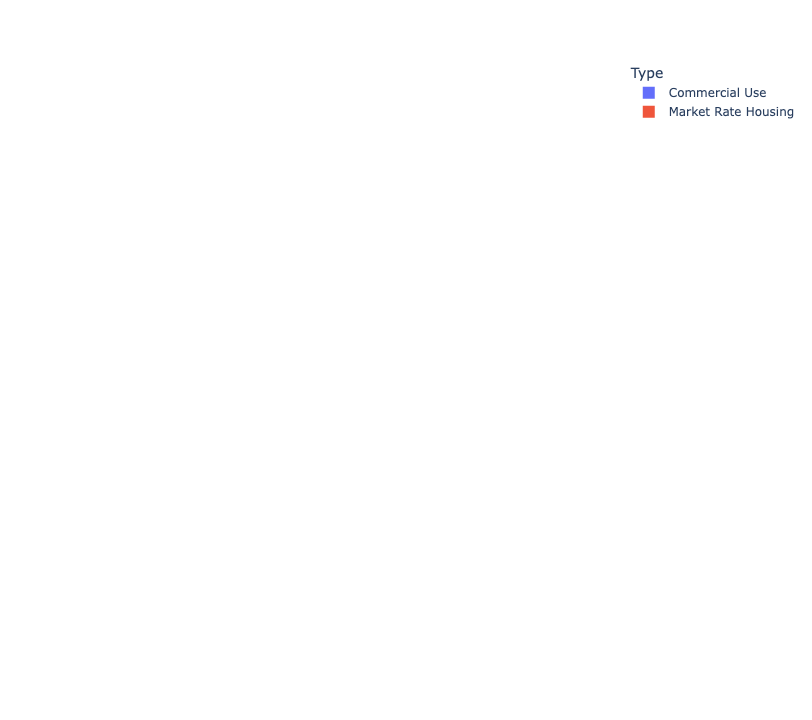

In [46]:
# Map market rate housing entitlement applications
fig = px.choropleth_mapbox(entitlements_merge_ain, geojson=entitlements_merge_ain.geometry, 
                           locations = entitlements_merge_ain.index,
                           center={"lat": 34.06232819030761, "lon": -118.23900742434343},color="Type",mapbox_style="carto-positron", 
                           zoom=13.5,opacity = 0.9, hover_data=["Type","SitusFullA_y"])
fig.update_traces(hovertemplate='<b>%{customdata[0]}</b><br>%{customdata[1]}<extra></extra>')
fig.show()
fig.write_html("market_rate_housing_entitlement_applications_chinatown.html")

## Recently Sold Parcels

Now I'll take a look at the recently sold parcel data and separate by use type. The data is from ArcGIS, so Yoh wrote us a function that allows us to import data from ArcGIS server, as well as bypassing the 1000 record limit imposed by ArcGIS Server so we can download the entire dataset.

In [263]:
def query_arcgis_feature_server(url_feature_server=''):
    '''
    This function downloads all of the features available on a given ArcGIS 
    feature server. The function is written to bypass the limitations imposed
    by the online service, such as only returning up to 1,000 or 2,000 featues
    at a time.

    Parameters
    ----------
    url_feature_server : string
        Sting containing the URL of the service API you want to query. It should 
        end in a forward slash and look something like this:
        'https://services.arcgis.com/P3ePLMYs2RVChkJx/arcgis/rest/services/USA_Counties/FeatureServer/0/'

    Returns
    -------
    geodata_final : gpd.GeoDataFrame
        This is a GeoDataFrame that contains all of the features from the 
        Feature Server. After calling this function, the `geodata_final` object 
        can be used to store the data on disk in several different formats 
        including, but not limited to, Shapefile (.shp), GeoJSON (.geojson), 
        GeoPackage (.gpkg), or PostGIS.
        See https://geopandas.org/en/stable/docs/user_guide/io.html#writing-spatial-data
        for more details.

    '''
    if url_feature_server == '':
        geodata_final = gpd.GeoDataFrame()
        return geodata_final

    # Fixing last character in case the URL provided didn't end in a 
    # forward slash
    if url_feature_server[-1] != '/':
        url_feature_server = url_feature_server + '/'
    
    # Getting the layer definitions. This contains important info such as the 
    # name of the column used as feature_ids/object_ids, among other things.
    layer_def = requests.get(url_feature_server + '?f=pjson').json()
    
    # The `objectIdField` is the column name used for the 
    # feature_ids/object_ids
    # fid_colname = layer_def['objectIdField']
    fid_colname = 'OBJECTID'

    
    # The `maxRecordCount` tells us the maximum number of records this REST 
    # API service can return at once. The code below is written such that we 
    # perform multiple calls to the API, each one being short enough never to 
    # go beyond this limit.
    record_count_max = layer_def['maxRecordCount']
    
    # Part of the URL that specifically requests only the object IDs
    url_query_get_ids = (f'query?f=geojson&returnIdsOnly=true'
                         f'&where={fid_colname}+is+not+null')
    
    url_comb = url_feature_server + url_query_get_ids
    
    # Getting all the object IDs
    service_request = requests.get(url_comb)
    # print(service_request.json())
    all_objectids = np.sort(service_request.json()['objectIds'])
    
    # This variable will store all the parts of the multiple queries. These 
    # parts will, at the end, be concatenated into one large GeoDataFrame.
    geodata_parts = []
    
    # This part of the query is fixed and never actually changes
    url_query_fixed = ('query?f=geojson&outFields=*&where=')

        # Identifying the largest query size allowed per request. This will dictate 
    # how many queries will need to be made. We start the search at
    # the max record count, but that generates errors sometimes - the query 
    # might time out because it's too big. If the test query times out, we try 
    # shrink the query size until the test query goes through without 
    # generating a time-out error.
    block_size = min(record_count_max, len(all_objectids))
    worked = False
    while not worked:
        # Moving the "cursors" to their appropriate locations
        id_start = all_objectids[0]
        id_end = all_objectids[block_size-1]

        readable_query_string = (f'{fid_colname}>={id_start} '
                                 f'and {fid_colname}<={id_end}')
        
        url_query_variable =  urllib.parse.quote(readable_query_string)
    
        url_comb = url_feature_server + url_query_fixed + url_query_variable
        
        url_get = requests.get(url_comb)
        
        if 'error' in url_get.json():
            block_size = int(block_size/2)+1
        else:
            geodata_part = gpd.read_file(url_get.text)
            
            geodata_parts.append(geodata_part.copy())
            worked = True
    
    # Performing the actual query to the API multiple times. This skips the 
    # first few rows/features in the data because those rows were already 
    # captured in the query performed in the code chunk above.
    for i in range(block_size, len(all_objectids), block_size):
        # Moving the "cursors" to their appropriate locations and finding the 
        # limits of each block
        sub_list = all_objectids[i:i + block_size]
        id_start = sub_list[0]
        id_end = sub_list[-1]

        readable_query_string = (f'{fid_colname}>={id_start} '
                                 f'and {fid_colname}<={id_end}')
        
        # Encoding from readable text to URL
        url_query_variable =  urllib.parse.quote(readable_query_string)
    
        # Constructing the full request URL
        url_comb = url_feature_server + url_query_fixed + url_query_variable
        
        # Actually performing the query and storing its results in a 
        # GeoDataFrame
        geodata_part =  (gpd.read_file(url_comb, 
                                       driver='GeoJSON'))
        
        # Appending the result to `geodata_parts`
        if geodata_part.shape[0] > 0:
            geodata_parts.append(geodata_part)

    # Concatenating all of the query parts into one large GeoDataFrame
    geodata_final = (pd.concat(geodata_parts, 
                               ignore_index=True)
                     .sort_values(by=fid_colname)
                     .reset_index(drop=True))
    
    # Checking if any object ID is missing
    ids_queried = set(geodata_final[fid_colname])
    for i,this_id in enumerate(all_objectids):
        if this_id not in ids_queried:
            print('WARNING! The following ObjectID is missing from the final '
                  f'GeoDataFrame: ObjectID={this_id}')
            pass
    
    # Checking if any object ID is included twice
    geodata_temp = geodata_final[[fid_colname]].copy()
    geodata_temp['temp'] = 1
    geodata_temp = (geodata_temp
                    .groupby(fid_colname)
                    .agg({'temp':'sum'})
                    .reset_index())
    geodata_temp = geodata_temp.loc[geodata_temp['temp']>1].copy()
    for i,this_id in enumerate(geodata_temp[fid_colname].values):
        n_times = geodata_temp['temp'].values[i]
        print('WARNING! The following ObjectID is included multiple times in'
              f'the final GeoDataFrame: ObjectID={this_id}\tOccurrences={n_times}')
    
    return geodata_final

In [264]:
# define your arc server url endpoint
url='https://egispais.gis.lacounty.gov/pais/rest/services/PAIS/pais_sales_parcels/MapServer/0/'

In [265]:
# make the function call and put results in a variable 'parcel'
parcel = query_arcgis_feature_server(url)

In [266]:
parcel.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 141050 entries, 0 to 141049
Data columns (total 22 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   OBJECTID             141050 non-null  int64   
 1   AIN                  141050 non-null  object  
 2   FORMATTED_AIN        141050 non-null  object  
 3   SAADDR               141050 non-null  object  
 4   SAADDR2              141050 non-null  object  
 5   SALEDATE             141050 non-null  int64   
 6   FORMATTED_SALEDATE   141050 non-null  object  
 7   SALEPRICE            141050 non-null  int64   
 8   SIZE                 133566 non-null  float64 
 9   BEDROOMS             127833 non-null  float64 
 10  BATHROOMS            128866 non-null  float64 
 11  YEARBUILT            141050 non-null  object  
 12  EFFECTIVE_YEARBUILT  141050 non-null  object  
 13  USECODE              141050 non-null  object  
 14  USETYPE              141050 non-null  object

In [267]:
parcel.sample()

,OBJECTID,AIN,FORMATTED_AIN,SAADDR,SAADDR2,SALEDATE,FORMATTED_SALEDATE,SALEPRICE,SIZE,BEDROOMS,...,EFFECTIVE_YEARBUILT,USECODE,USETYPE,SASTR,SANUM,SAFRACT,SAUNIT,FORMATTED_SALEPRICE,FORMATTED_SIZE,geometry
45505,854803,6191015013,6191-015-013,10748 CALIFORNIA AVE,LYNWOOD CA 90262,1631836800000,09/17/2021,2425024,4354.0,8.0,...,1955,0500,R-I,CALIFORNIA AVE,10748,,,"$2,425,024","4,354","POLYGON ((-118.20796 33.93564, -118.20822 33.9..."


### Merging the Data
Next I'm going to spatial joinn the ArcGIS data to Parcel Geographic boundaries, but first I have to rename the column title in the ArcGIS data from AIN to APN, so I can merge on that attribute. AIN and APN are interchangeable, APNs are most commonly referred to as Assessor Parcel Numbers, but may also be known as Assessor's Identification Numbers (AINs).

In order to prevent duplicate columns in the merge, I will first create a df with the difference of the columns between my two dataframes. Then, I will merge selecting only the non-duplicate columns.

In [268]:
columns_to_use = parcel_chinatown.columns.difference(parcel.columns).union(['AIN'])
columns_to_use
recently_sold_df = parcel.merge(parcel_chinatown[columns_to_use], on='AIN')

I'll trim the columns in the merged Recently Sold df to just the data I'm interested in.

In [269]:
recently_sold_df.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 71 entries, 0 to 70
Data columns (total 112 columns):
 #    Column               Non-Null Count  Dtype   
---   ------               --------------  -----   
 0    OBJECTID             71 non-null     int64   
 1    AIN                  71 non-null     object  
 2    FORMATTED_AIN        71 non-null     object  
 3    SAADDR               71 non-null     object  
 4    SAADDR2              71 non-null     object  
 5    SALEDATE             71 non-null     int64   
 6    FORMATTED_SALEDATE   71 non-null     object  
 7    SALEPRICE            71 non-null     int64   
 8    SIZE                 71 non-null     float64 
 9    BEDROOMS             62 non-null     float64 
 10   BATHROOMS            62 non-null     float64 
 11   YEARBUILT            71 non-null     object  
 12   EFFECTIVE_YEARBUILT  71 non-null     object  
 13   USECODE              71 non-null     object  
 14   USETYPE              71 non-null     object  
 15 

In [364]:
desired_columns = ['AIN','SitusFullA','LAT_LON','FORMATTED_SALEDATE','SALEPRICE','YearBuilt1','USETYPE','geometry']
recently_sold_df_clipped = recently_sold_df[desired_columns].copy()

Looking at the Usetype column, I'm going to replace the entries so that instead of the code, we'll see the actual label associated with it. For example, instead of SFR, the listing will state "Single Family Residence."

In [271]:
recently_sold_df_clipped['USETYPE'] = recently_sold_df_clipped['USETYPE'].replace(['C/I', 'CND', 'OTH', 'R-I', 'SFR', 'VAC'], ['Commercial / Industrial', 'Condominium', 'Other', 'Multiple Family Residence', 'Single Family Residence', 'Vacant Land'])

In [302]:
recently_sold_df_clipped.info()
recently_sold_df_clipped.head(10)

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 71 entries, 0 to 70
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   AIN                 71 non-null     object  
 1   SitusFullA          71 non-null     object  
 2   LAT_LON             67 non-null     object  
 3   FORMATTED_SALEDATE  71 non-null     object  
 4   SALEPRICE           71 non-null     int64   
 5   YearBuilt1          70 non-null     object  
 6   USETYPE             71 non-null     object  
 7   geometry            71 non-null     geometry
dtypes: geometry(1), int64(1), object(6)
memory usage: 5.0+ KB


,AIN,SitusFullA,LAT_LON,FORMATTED_SALEDATE,SALEPRICE,YearBuilt1,USETYPE,geometry
0,5407007012,841 N BUNKER HILL AVE LOS ANGELES CA 90012,"34.064510, -118.242904",09/02/2021,2645026,1980,Multiple Family Residence,"POLYGON ((-118.24281 34.06435, -118.24289 34.0..."
1,5407008002,704 W COLLEGE ST LOS ANGELES CA 90012,"34.065188, -118.241607",04/13/2022,1000010,1959,Multiple Family Residence,"POLYGON ((-118.24153 34.06534, -118.24161 34.0..."
2,5407010008,649 ALPINE ST LOS ANGELES CA 90012,"34.063835, -118.242286",12/16/2022,1025010,1973,Multiple Family Residence,"POLYGON ((-118.24225 34.06369, -118.24222 34.0..."
3,5407009018,821 CLEVELAND ST LOS ANGELES CA 90012,"34.064125, -118.241533",03/18/2022,4500045,1972,Multiple Family Residence,"POLYGON ((-118.24165 34.06429, -118.24167 34.0..."
4,5407017028,630 N GRAND AVE UNIT 103 LOS ANGELES CA 90012,"34.061431, -118.243022",12/02/2022,530005,1982,Condominium,"POLYGON ((-118.24287 34.06158, -118.24288 34.0..."
5,5407012008,713 N GRAND AVE LOS ANGELES CA 90012,"34.063016, -118.243666",05/13/2022,2150021,1987,Multiple Family Residence,"POLYGON ((-118.24347 34.06297, -118.24347 34.0..."
6,5407017005,624 N GRAND AVE LOS ANGELES CA 90012,"34.061161, -118.243033",05/21/2021,1675016,None,Vacant Land,"POLYGON ((-118.24319 34.06124, -118.24320 34.0..."
7,5407017039,630 N GRAND AVE UNIT 304 LOS ANGELES CA 90012,"34.061431, -118.243022",09/09/2021,505005,1982,Condominium,"POLYGON ((-118.24287 34.06158, -118.24288 34.0..."
8,5407022019,756 N HILL PL 1 LOS ANGELES CA 90012,"34.063003, -118.242349",07/21/2021,820008,1972,Multiple Family Residence,"POLYGON ((-118.24222 34.06301, -118.24251 34.0..."
9,5407024018,729 YALE ST LOS ANGELES CA 90012,"34.062098, -118.241775",05/31/2022,1780017,1973,Multiple Family Residence,"POLYGON ((-118.24151 34.06209, -118.24198 34.0..."


### Recently Sold Parcels Data Visualizations

#### Interactive map of recently sold parcels and entitlement applications

In [322]:
entitlements_merge_ain['FILING_DT']
# Update Determination column with empty or blank rows to include Case on Hold text
entitlements_merge_ain.loc[entitlements_merge_ain['DETERMINATION'] == '', 'DETERMINATION'] = 'Case on Hold'
# Change capitalization of determinations from all caps to title case
entitlements_merge_ain['DETERMINATION'] = entitlements_merge_ain['DETERMINATION'].str.title()

In [385]:
# Create new column in recently sold parcels to store map symbology
recently_sold_df_clipped['Symbol'] = 'Recently Sold Parcel'
# Create new column in entitlement applications to store map symbology
entitlements_merge_ain['Symbol'] = 'Entitlement Application'
# Filter entitlements by market rate housing
entitlements_market_rate = entitlements_merge_ain[entitlements_merge_ain['Type']=='Market Rate Housing'].copy()

plotly express hovertemplate: Neighborhood Boundary=Chinatown<br>index=%{location}<extra></extra>


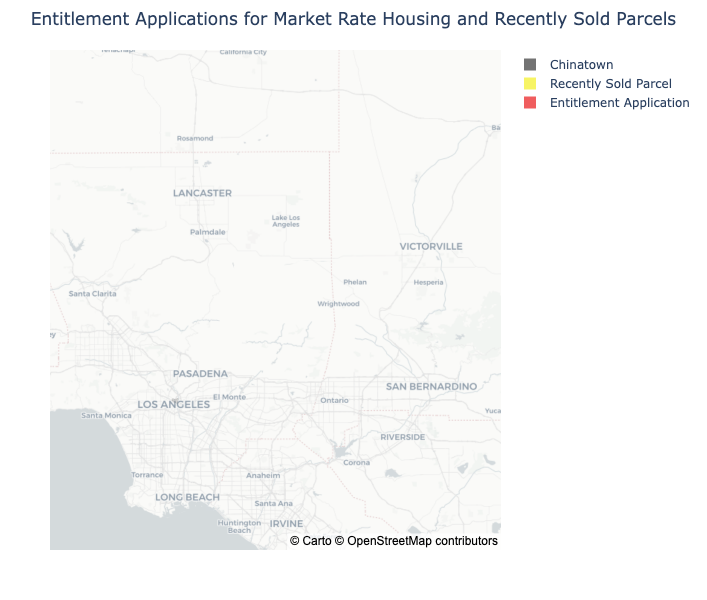

In [391]:
# Import Chinatown neighborhood boundary geojson file directly from source
neighborhood = gpd.read_file("https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LA_Times_Neighborhoods/FeatureServer/0/query?where=name%20%3D%20'CHINATOWN'&outFields=*&outSR=4326&f=geojson")

# Plot Chinatown neighborhood boundary
fig = px.choropleth_mapbox(neighborhood, geojson=neighborhood.geometry, locations=neighborhood.index,color="name",
                            labels={"name": "Neighborhood Boundary"},color_discrete_map={"Chinatown": '#737373'}, 
                           opacity=0.28, mapbox_style="carto-positron", center={"lat": 34.06310811864443, "lon": -118.23870091769122},
                          zoom=13.5)

# Plot recently sold parcels
sale_fig = px.choropleth_mapbox(recently_sold_df_clipped, geojson=recently_sold_df_clipped.geometry, locations=recently_sold_df_clipped.index, 
                           color='Symbol', zoom=13.5, center={"lat": 34.06310811864443, "lon": -118.23870091769122}, 
                           mapbox_style="carto-positron",color_discrete_sequence=["#F7F464"], opacity=0.8, hover_data=["FORMATTED_SALEDATE"])

# Plot entitlement applications
ent_fig = px.choropleth_mapbox(entitlements_merge_ain, entitlements_merge_ain.geometry, 
                               locations=entitlements_merge_ain.index,color='Symbol',
                               color_discrete_sequence=["#F05D5E"], opacity=0.5)


# Overlay recently sold parcels, entitlement applications, Chinatown boundary
fig.add_trace(sale_fig.data[0])
fig.add_trace(ent_fig.data[0])

fig.update_traces(marker_line_width=0)
print("plotly express hovertemplate:", fig.data[0].hovertemplate)
fig.update_layout(width = 800,height = 600,title = "Entitlement Applications for Market Rate Housing and Recently Sold Parcels",title_x=0.5)
fig.update_layout(legend_title_text='')
fig.update_layout(margin=dict(l=50,r=50,b=50,t=50))

# Show map
fig.show()

fig.write_html("recently_sold_parcels_entitlements.html")

#### Static map of recently sold parcels and entitlement applications

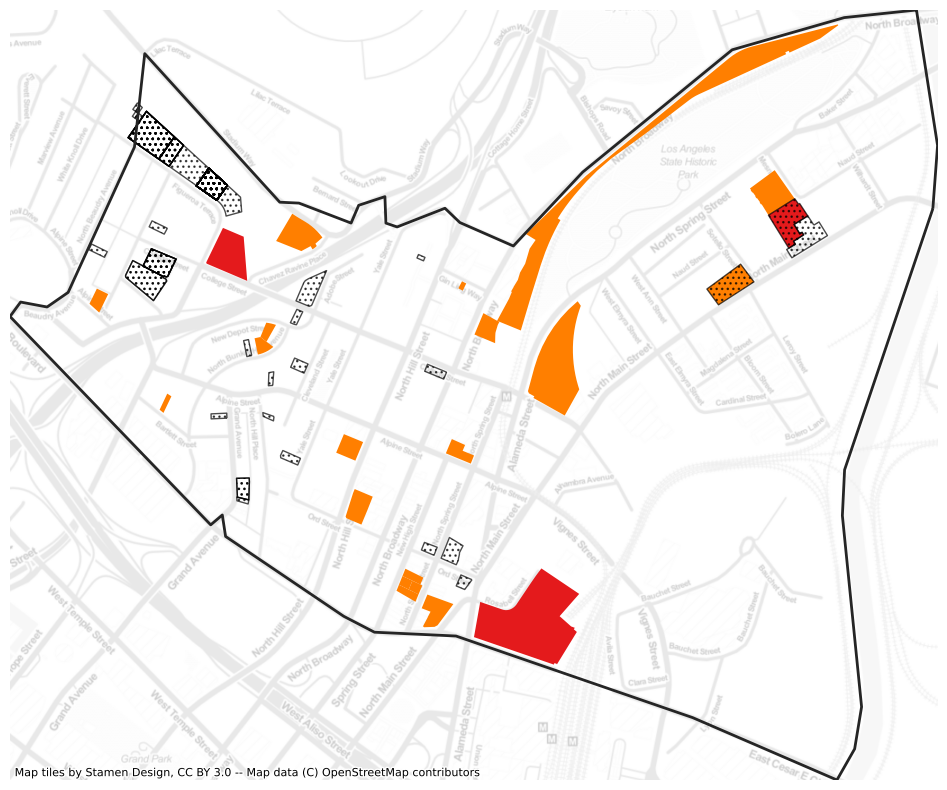

In [99]:
# Set axis limits based on data extent of Chinatown neighborhood boundary
minx, miny, maxx, maxy = chinatown_neighborhood.total_bounds

fig, ax = plt.subplots(figsize=(12,10))

# Plot entitlement applications for market rate housing
entitlements_merge_ain[entitlements_merge_ain['Type']=='Market Rate Housing'].plot(ax=ax,color='#ff7f00',legend=True)
ax.axis('off')

# Plot entitlement applications for non-residential square footage
entitlements_merge_ain[entitlements_merge_ain['Type']=='Commercial'].plot(ax=ax,color='#e41a1c')

# Plot recently-sold parcels
recently_sold_df_unique.plot(ax=ax,facecolor='none', hatch="...",alpha=0.7)
ax.axis('off')
ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite,crs=4326,alpha=0.2)

# Plot Chinatown neighborhood boundaries
chinatown_neighborhood = gpd.read_file("https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LA_Times_Neighborhoods/FeatureServer/0/query?where=name%20%3D%20'CHINATOWN'&outFields=*&outSR=4326&f=geojson")
chinatown_neighborhood.plot(ax=ax,facecolor='none',edgecolor='#252525',linewidth=2)
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)

# Write map to file
plt.savefig('entitlements_recently_sold_polygon.pdf')

# **Transit Oriented Communities TOC**

## _Purpose_
City of LA uses the ZIMAS online mapping system for parcel level TOC Tier information. ZIMAS does not allow data exports, so I'm going to scrape the TOC Tier values for each parcel in Chinatown from ZIMAS.

I will inspect the HTML of the ZIMAS website (http://zimas.lacity.org/) on a Chrome browser to find out which requests gives me the desired data.

I will access the ZIMAS website using code, search by APN, and extract the TOC Tier information for each parcel. 

## _Specify the range to iterate through the loop_
Because I want to search each parcel by its APN, the range of the loop should be the APNs of all parcels.
### Create a list of APNs (without hyphens) for all parcels in Chinatown

In [9]:
# Save APN column of Chinatown parcel geodataframe
parcel_chinatown_apn = parcel_chinatown['APN'].copy()
# Remove the hyphens in the APN column (replace hyphens with empty strings)
parcel_chinatown_apn['APN'] = parcel_chinatown.APN.str.replace('-','')

### Create a new dataframe to store the TOC tier information for each parcel

In [10]:
# Create an empty dataframe with 2 columns, 1 for APN, 1 for TOC
parcel_chinatown_toc = pd.DataFrame(columns = ['APN', 'TOC'])

## _Run a loop to scrape TOC Tier values from ZIMAS_
Before running the loop, I have 2 different dataframes:  
1. parcel_chinatown_apn: all APN values
2. parcel_chinatown_toc: only APN values iterated over on the for loop  
  
  I will use the list of all APNs as the range of the for loop. I will then use the difference between the 2 dataframes to check whether all parcels were iterated over.  
  
  When I first open the ZIMAS website, I have to accept the ZIMAS Terms and Conditions. Afterwards, I am prompted to select Search by APN on a pop-window. I then type the APN into the search box and click the GO button.  
    
ZIMAS responds by loading the parcel information. The parcel information is stored in 12 tabs on the lefthand side of the window:  
1. Address/Legal (contains APN and Site Address)
2. Jurisdictional
3. Permitting and Zoning Compliance
4. Planning and Zoning (contains TOC Tier)
5. Assessor
6. Case Numbers
7. Citywide/Code Amendment Cases
8. Additional
9. Seismic Hazards
10. Economic Development Areas
11. Housing
12. Public Safety

In [45]:
# For each APN in the list of Chinatown parcel APNs
for apn in parcel_chinatown_apn:
    # Open ZIMAS website on Chrome browser
    driver = webdriver.Chrome()
    driver.get("http://zimas.lacity.org")
    # Find the Accept button by ID
    accept_button = driver.find_element(By.ID,'btn')
    # Click Accept
    accept_button.click()
    # Find the Search by APN button by partial link text ('Assessor Parcel No.')
    search_by_case_no_button = driver.find_element(By.XPATH,"//a[contains(text(),'Parcel No.')]")
    # Wait for element to be clickable, click Search by APN
    wait = WebDriverWait(driver, 30)
    wait.until(EC.element_to_be_clickable((By.XPATH,"//a[contains(text(),'Parcel No.')]"))).click()
    # Find the Enter Assessor Parcel Number by ID
    apn_box = driver.find_element(By.ID,'txtAPN')
    # Send the APN to the Enter Assessor Parcel Number box
    apn_box.send_keys(apn)
    # Find the GO button
    go_button = driver.find_element(By.XPATH, "//input[@value='GO'][@type='button']")
    # Click the GO button
    go_button.click()
    try:
        # Find the Planning and Zoning tab by XPATH
        # Wait for element to be clickable, click Planning and Zoning tab by XPATH
        wait.until(EC.invisibility_of_element((By.XPATH, "//div[@id='divModalUnderlay']")))
        wait.until(EC.element_to_be_clickable((By.XPATH,"//div[@id='divDataTabs']/table/tbody/tr[7]/td/a"))).click()
        # Get TOC Tier value, which is under the Planning and Zoning tab of the table
        # Inspected source code of ZIMAS website to get full XPATH to TOC value
        # Full XPATH to TOC value is //*[@id="divTab3"]/table/tbody/tr[40]/td[2]/a
        # TOC value is in 2nd column of divTab3 results 
        # Row number of TOC value is usually BUT NOT ALWAYS 40th row of the 2nd column
        # If element cannot be found using TOC link, TOC value likely is"Not Eligible"
        # Get element through text - if contains "Not Eligible" text
        # Syntax: driver.find_element_by_xpath(“//tag [contains( text(), ‘word’)]”)
        # tag = tag name which contains the particular word
        # word = search text
        toc_label = driver.find_element(By.XPATH,"//div[@id='divTab3']/table/tbody/tr/td/a[contains(@onclick,'toc_tiers.htm')]")
        # Identify parent element from child element with (..) in XPATH
        # Transit Oriented Communities row label = child element
        toc_label_parent = toc_label.find_element(By.XPATH,'..')
        # Use get_attribute() to get class of parent element
        # Expect to get DataCellsLeft
        # Get next sibling element with following-sibling
        toc_value = toc_label_parent.find_element(By.XPATH,"./following-sibling::td[1]")
        # toc_value = driver.find_element(By.XPATH,"//div[@id='divTab3']/table/tbody/tr/td/a[contains(@onclick,'Transit Oriented Communities')]")
        print(toc_value.text)
        # Append ZIMAS APN and TOC Tier to empty dataframe
        parcel_chinatown_toc = parcel_chinatown_toc.append({'APN': str(apn), 'TOC': toc_value.text}, ignore_index=True)
        driver.quit()
    except NoSuchElementException:  
        driver.quit()
        continue
    except TimeoutException:
    # If there are no ZIMAS result for the APN, there will be a DIV with an error message with red text.
    # Error message: "There were no results for the search you entered, please try your search again.
    # Error message is inside DIV "divSearchResultsError"
    # Identify if there is an error message by finding DIV element by ID and checking if the list is empty
        no_results_error = driver.find_elements(By.XPATH,"//div[@id='divSearchResultsError']")
    # Check length of list of elements
    # If list is empty and length is 0, append "NaN" to APN and Address
        if len(no_results_error) == 0:
            driver.quit()
        else:
            parcel_chinatown_toc = parcel_chinatown_toc.append({'APN': str(apn), 'TOC': "NaN"}, ignore_index=True)
            driver.quit()
    except StaleElementReferenceException:
        continue

WebDriverException: Message: Service chromedriver unexpectedly exited. Status code was: 127


### Find APNs in the empty dataframe but NOT in the dataframe with all APNs

In [48]:
# Use NumPy's setdiff1d function (array1,array2,assume_unique=False)
# Yields the unique values in array1 that are not in array2
diff = np.setdiff1d(parcel_chinatown_apn,parcel_chinatown_toc['APN'])
diff_list = diff.tolist()
len(diff_list)

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [132]:
# Import CSV of parcels with entitlement applications in Chinatown
parcels_toc = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/parcel_chinatown_toc_tiers_zimas.csv")
parcels_toc.head(5)
# Possible options for TOC Tier
parcels_toc['TOC'].unique()
# Drop empty geometry column
parcels_toc.dropna(how='all', axis=1, inplace=True)
# Filter out rows with NaN values in TOC column, using is not != operator
parcels_toc_filter = parcels_toc[parcels_toc['TOC'] != 'NaN'].copy()

## TOC Tier Visualizations

plotly express hovertemplate: TOC Tier=%{customdata[0]}<br>index=%{location}<extra></extra>


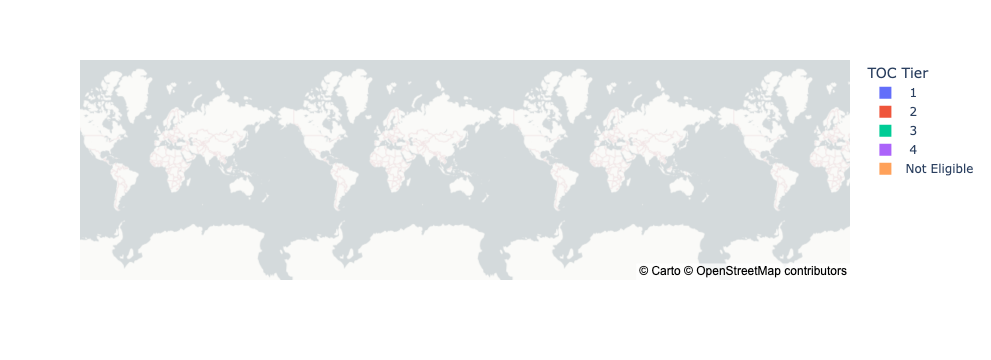

In [170]:
# Attribute join APNs from parcel TOC Tiers to AINs parcel geographic boundaries
# Remove the hyphens in the APN column (replace hyphens with empty strings)
parcel_chinatown['APN'] = parcel_chinatown.APN.str.replace('-','')
# Merge on APN attribute
parcels_toc_shapes = parcel_chinatown.merge(parcels_toc_filter,on='APN')
# To facilitate sorting, update TOC column to only include number of tier (replace 'Tier' with empty strings)
parcels_toc_shapes['TOC'] = parcels_toc_shapes.TOC.str.replace('Tier','')
# Sort by column 'TOC'
parcels_toc_shapes = parcels_toc_shapes.sort_values(by=['TOC'], ascending=True)

# Map parcels by TOC Tiers
fig = px.choropleth_mapbox(parcels_toc_shapes, geojson=parcels_toc_shapes.geometry, locations = parcels_toc_shapes.index,
                            color="TOC", center={"lat": 34.06310811864443, "lon": -118.23870091769122},
                            mapbox_style="carto-positron", zoom=12.5, labels={"TOC": "TOC Tier"},hover_data=["TOC"])
print("plotly express hovertemplate:", fig.data[0].hovertemplate)
fig.update_traces(hovertemplate='TOC Tier %{customdata[0]}<extra></extra>')


# Show map
fig.show()

# fig.write_html("toc_tiers_chinatown.html")

In [ ]:
# Plot Chinatown Metro Station
chinatown_metro = gpd.read_file("https://public.gis.lacounty.gov/public/rest/services/LACounty_Dynamic/LMS_Data_Public/MapServer/185/query?where=Name%20%3D%20'CHINATOWN%20METRO%20STATION'&outFields=*&outSR=4326&f=geojson")
chinatown_metro.plot(ax=ax,color='#fed976')
# Plot LA State Historic Park
la_hist_park = gpd.read_file("https://services1.arcgis.com/X1hcdGx5Fxqn4d0j/arcgis/rest/services/Conservation_Lands/FeatureServer/1/query?where=UNITNAME%20%3D%20'LOS%20ANGELES%20SHP'&outFields=*&outSR=4326&f=geojson")
la_hist_park.plot(ax=ax,color='#78c679')
# Plot existing market-rate developments
recently_sold_df_clipped.plot(ax=ax,
                              column = 'USETYPE',
                              cmap='cool',
                              legend=True,
         legend_kwds={'loc':'upper left','bbox_to_anchor':(1,.9)})

## LAPD Calls for Landlord Tenant Disputes

### Import data

#### Import LAPD landlord/tenant dispute calls in LAPD Central Reporting District from 2010-2022

In [20]:
# Import 2010 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2010 = pd.read_csv("https://data.lacity.org/resource/iy4q-t9vr.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2011 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2011 = pd.read_csv("https://data.lacity.org/resource/4tmc-7r6g.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60reporting_district%60%2C%0A%20%20%60area_occurred%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_description%60%0AWHERE%0A%20%20(%60reporting_district%60%20%3D%20%220111%22)%0A%20%20AND%20contains(%60call_type_description%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2012 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2012 = pd.read_csv("https://data.lacity.org/resource/i7pm-cnmm.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60reporting_district%60%2C%0A%20%20%60area_occurred%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_description%60%0AWHERE%0A%20%20(%60reporting_district%60%20%3D%20%220111%22)%0A%20%20AND%20contains(%60call_type_description%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2013 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2013 = pd.read_csv("https://data.lacity.org/resource/urhh-yf63.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60reporting_district%60%2C%0A%20%20%60area_occurred%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_description%60%0AWHERE%0A%20%20(%60reporting_district%60%20%3D%20%220111%22)%0A%20%20AND%20contains(%60call_type_description%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2014 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2014 = pd.read_csv("https://data.lacity.org/resource/mgue-vbsx.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2015 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2015 = pd.read_csv("https://data.lacity.org/resource/tss8-455b.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%22111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2016 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2016 = pd.read_csv("https://data.lacity.org/resource/xwgr-xw5q.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2017 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2017 = pd.read_csv("https://data.lacity.org/resource/ryvm-a59m.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60reporting_district%60%2C%0A%20%20%60area_occurred%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_description%60%0AWHERE%0A%20%20(%60reporting_district%60%20%3D%20%220111%22)%0A%20%20AND%20contains(%60call_type_description%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2018 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2018 = pd.read_csv("https://data.lacity.org/resource/nayp-w2tw.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20DESC%20NULL%20LAST")
# Import 2019 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2019 = pd.read_csv("https://data.lacity.org/resource/r4ka-x5je.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)%0AORDER%20BY%20%60dispatch_date%60%20ASC%20NULL%20LAST")
# Import 2020 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2020 = pd.read_csv("https://data.lacity.org/resource/84iq-i2r6.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)")
# Import 2021 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2021 = pd.read_csv("https://data.lacity.org/resource/cibt-wiru.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%20(%60rpt_dist%60%20%3D%20%220111%22)%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)")
# Import 2022 LAPD landlord/tenant dispute calls in LAPD Central Reporting District 011 directly from source LA City Open Data
calls_2022 = pd.read_csv("https://data.lacity.org/resource/u6ri-98iw.csv?$query=SELECT%0A%20%20%60incident_number%60%2C%0A%20%20%60area_occ%60%2C%0A%20%20%60rpt_dist%60%2C%0A%20%20%60dispatch_date%60%2C%0A%20%20%60dispatch_time%60%2C%0A%20%20%60call_type_code%60%2C%0A%20%20%60call_type_text%60%0AWHERE%0A%20%20(%60rpt_dist%60%20IN%20(%220111%22))%20AND%20contains(%60call_type_text%60%2C%20%22LANDLORD%22)")

#### Import LAPD reporting districts in Chinatown

In [21]:
# Import LAPD reporting districts in Chinatown
lapd_reporting_districts = gpd.read_file("https://public.gis.lacounty.gov/public/rest/services/LACounty_Dynamic/Administrative_Boundaries/MapServer/8/query?where=LABEL%20%3D%20'CENTRAL%20DIVISION'&outFields=*&outSR=4326&f=geojson")

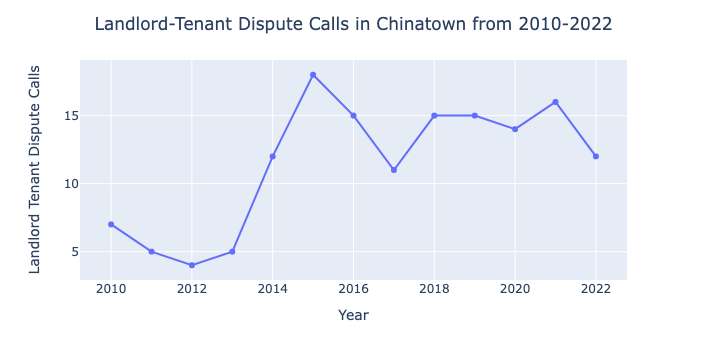

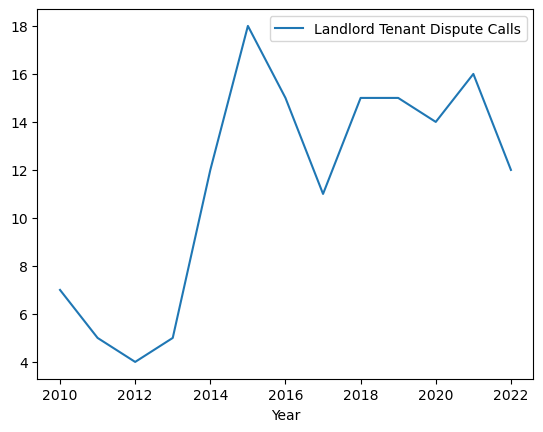

In [22]:
# Concatenate dataframes
calls_2010_2022 = pd.concat([calls_2010, calls_2011, calls_2012, calls_2013, calls_2014, calls_2015, calls_2016, 
                             calls_2017, calls_2018, calls_2019, calls_2020, calls_2021, calls_2022], axis=0)
# 149 LAPD calls involving landlord/tenant disputes between 2010-2022
# Count LAPD calls in each year between 2010-2022
calls_2010_2022_counts = [calls_2010_2022['dispatch_date'].str.contains('2010').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2011').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2012').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2013').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2014').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2015').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2016').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2017').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2018').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2019').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2020').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2021').value_counts()[True],
                          calls_2010_2022['dispatch_date'].str.contains('2022').value_counts()[True]]
years = [2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022]
calls_2010_2022_counts_by_year = pd.DataFrame(calls_2010_2022_counts,columns=['Landlord Tenant Dispute Calls'],index=years)
# Rename index column name
calls_2010_2022_counts_by_year.index.names = ['Year']
calls_2010_2022_counts_by_year.head(5)
calls_2010_2022_counts_by_year.plot()
fig = px.line(calls_2010_2022_counts_by_year, x=calls_2010_2022_counts_by_year.index, y="Landlord Tenant Dispute Calls",markers=True)
fig.update_layout(title = "Landlord-Tenant Dispute Calls in Chinatown from 2010-2022",title_x=0.5)
fig.show()
fig.write_html("lapd-landlord-tenant-dispute-calls.html")

# Rent Stabilized Ordinance RSO Units

## _Import data_

In [148]:
# Import RSO units from 2016-2022, downloaded from LAHD
# Read in RSO parcel geojson files
# 2016
rso_2016 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2016_shapes_clip.geojson")
# 2017
rso_2017 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2017_shapes_clip.geojson")
# 2018
rso_2018 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2018_shapes_clip.geojson")
# 2019
rso_2019 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2019_shapes_clip.geojson")
# 2020
rso_2020 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2020_shapes_clip.geojson")
# 2021
rso_2021 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2021_shapes_clip.geojson")
# 2022
rso_2022 = gpd.read_file("/home/jovyan/up221-group-project/up221-group-project/Data/LAHD/rso_2022_shapes_clip.geojson")

## _Count the number of RSO units for each year_

In [164]:
# For each year, calculate the sum of RSO Units column and combine in 1 array
rso_2016_2022_list = [rso_2016['RSO Units'].sum(),rso_2017['RSO Units'].sum(),rso_2018['RSO Units'].sum(),rso_2019['RSO Units'].sum(),rso_2020['RSO Units'].sum(),rso_2021['RSO Units'].sum(), rso_2022['RSO Units'].sum()]
# Create array of years in data 2016-2022
rso_years = [2016,2017,2018,2019,2020,2021,2022]
# Add both arrays to 1 dataframe
rso_2016_2022_df = pd.DataFrame(rso_2016_2022_list, index = rso_years,columns=['Total RSO Units'])
# Rename index name to year
rso_2016_2022_df.index.names = ['Year']
# Find minimum and maximum number of RSO units
rso_min = rso_2016_2022_df['Total RSO Units'].min()
rso_max = rso_2016_2022_df['Total RSO Units'].max()

## _Create a line graph of RSO units per year_

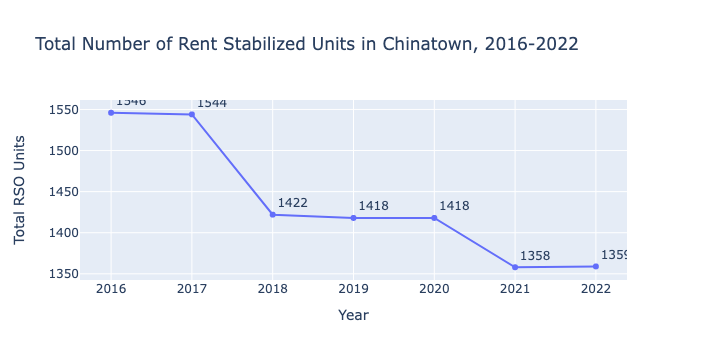

In [165]:
fig = px.line(rso_2016_2022_df, x=rso_2016_2022_df.index, y="Total RSO Units",text="Total RSO Units",title="Total Number of Rent Stabilized Units in Chinatown, 2016-2022")
fig.update_traces(textposition="top right")
fig.show()
fig.write_html("rso_units_count_2016_2022.html")

# Development Timeline

In [ ]:
# 1978: Approval of RSO
# Jan. 29, 2013: Adoption of Cornfield Arroyo Seco Plan (CASP)
# Nov. 2016: Creation of Transit Oriented Communities Program
# Jan. 25, 2017: Creation of Tenant Buyout Notification Program
# Sep. 22, 2017: Implementation of Transit Oriented Communities Program (Effective Date)
# Mar. 4, 2020: Declaration of COVID-19 Emergency Order and Eviction Moratorium
# Feb. 1, 2023: End of Eviction Moratorium

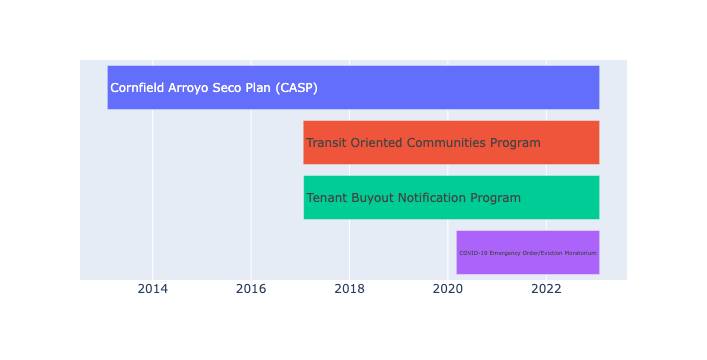

In [186]:
# Create a dataframe to store timeline events
timeline = pd.DataFrame([dict(Event='Cornfield Arroyo Seco Plan (CASP)', Start='2013-01-29', Finish='2023-02-01'),
    dict(Event='Transit Oriented Communities Program', Start='2017-01-22', Finish='2023-02-01'),
    dict(Event='Tenant Buyout Notification Program', Start='2017-01-25', Finish='2023-02-01'),
    dict(Event='COVID-19 Emergency Order/Eviction Moratorium', Start='2020-03-04', Finish='2023-02-01')
])

fig = px.timeline(timeline, x_start="Start", x_end="Finish", y="Event", color="Event", text="Event")
# Turn legend off
fig.update_layout(showlegend=False)
# Turn y axis off
fig.update_yaxes(visible=False)
fig.update_traces(textposition='inside',insidetextanchor="start")
fig.update_layout(uniformtext_minsize=10)
fig.show()

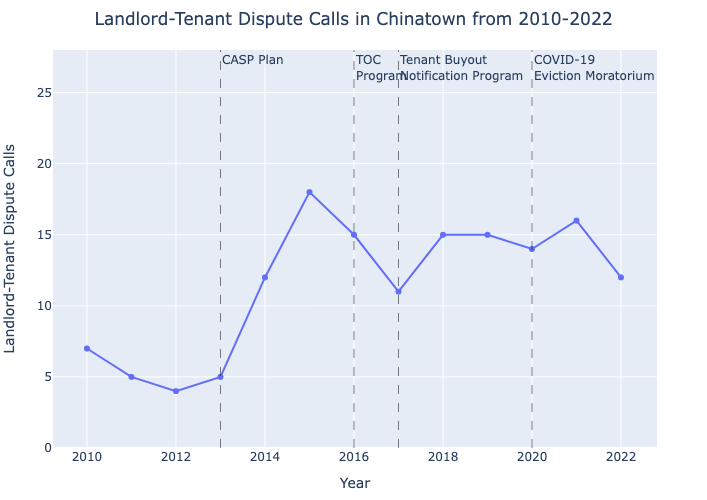

ValueError: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


In [31]:
# Find minimum and maximum number of landlord-tenant dispute calls
call_min = calls_2010_2022_counts_by_year['Landlord Tenant Dispute Calls'].min()
call_max = calls_2010_2022_counts_by_year['Landlord Tenant Dispute Calls'].max()

# Add vertical line annotations with timeline events
fig = go.Figure()

fig.add_vline(x=2013, line_width=1, line_dash="dash", line_color="black", opacity=0.5, 
              annotation_text="CASP Plan", 
              annotation_position="top right")

fig.add_vline(x=2016, line_width=1, line_dash="dash", line_color="black", opacity=0.5, 
              annotation_text="TOC<br>Program", 
              annotation_position="top right")

fig.add_vline(x=2017, line_width=1, line_dash="dash", line_color="black", opacity=0.5, 
              annotation_text="Tenant Buyout<br>Notification Program", 
              annotation_position="top right")

fig.add_vline(x=2020, line_width=1, line_dash="dash", line_color="black", opacity=0.5, 
              annotation_text="COVID-19<br>Eviction Moratorium", 
              annotation_position="top right")

fig.add_trace(go.Scatter(x=calls_2010_2022_counts_by_year.index, y=calls_2010_2022_counts_by_year['Landlord Tenant Dispute Calls'],
                    mode='lines+markers',name='Landlord-Tenant Dispute Calls', hovertemplate = '<b>%{x}<extra><b>%{y}</extra>'))

fig.update_annotations(align="left")

fig.update_layout(yaxis_range=[0,call_max+10])
fig.update_layout(title = "Landlord-Tenant Dispute Calls in Chinatown from 2010-2022",title_x=0.5)
fig.update_layout(autosize=False,width=950,height=500,yaxis=dict(title_text='Landlord-Tenant Dispute Calls'),
                  margin=dict(l=50,r=50,b=50,t=50),xaxis=dict(title_text='Year'))
fig.show()
fig.write_html("landlord_tenant_dispute_calls_timeline.html")
fig.write_image("landlord_tenant_dispute_calls_timeline.png", engine="kaleido")

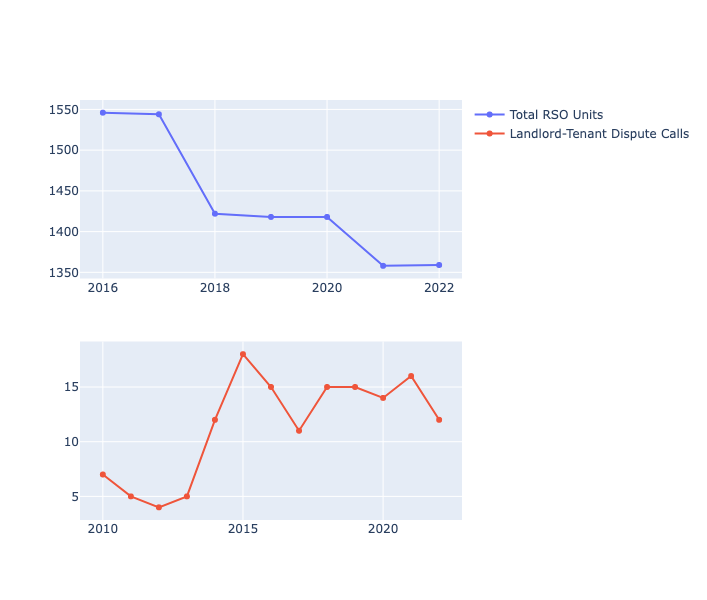

In [242]:
# Subplot arrangement: 2 rows, 1 column
fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=rso_2016_2022_df.index, y=rso_2016_2022_df['Total RSO Units'],
                    mode='lines+markers', name='Total RSO Units'),row=1, col=1)
fig.add_trace(go.Scatter(x=calls_2010_2022_counts_by_year.index, y=calls_2010_2022_counts_by_year['Landlord Tenant Dispute Calls'],
                    mode='lines+markers',name='Landlord-Tenant Dispute Calls'),row=2, col=1)
fig.update_layout(autosize=False,width=950,height=500)
fig.show()